<a href="https://colab.research.google.com/github/Z4HRA-S/Solar_Panel_Object_Detection/blob/main/Evaluation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Read the Data

In [ ]:
%cd drive/MyDrive/Colab\ Notebooks/proactive

/content/drive/MyDrive/Colab Notebooks/proactive


In [ ]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torchvision.transforms.functional as TF
import torchvision
import torch

In [ ]:
test_images = [Image.open("test_panel_data/1.jpg"), Image.open("test_panel_data/2.jpg"),Image.open("test_panel_data/3.jpg")]
test_images = [TF.to_tensor(img) for img in test_images]

Let's see out test images

In [ ]:
def plot(images):
  for image in images:
    image = image.transpose(0,2).transpose(0,1).detach().numpy()
    i, im = plt.subplots()
    i.set_figwidth(7)
    im.imshow(image)

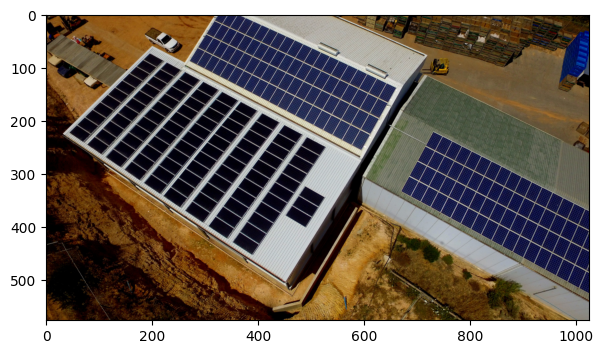

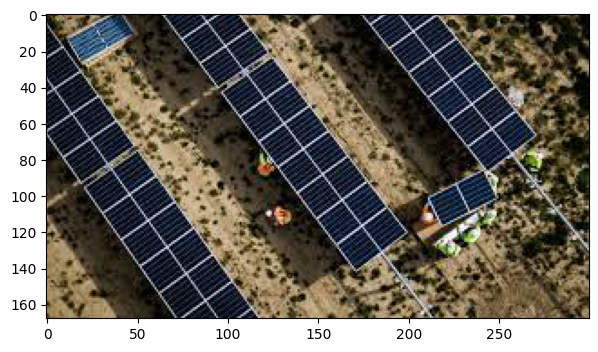

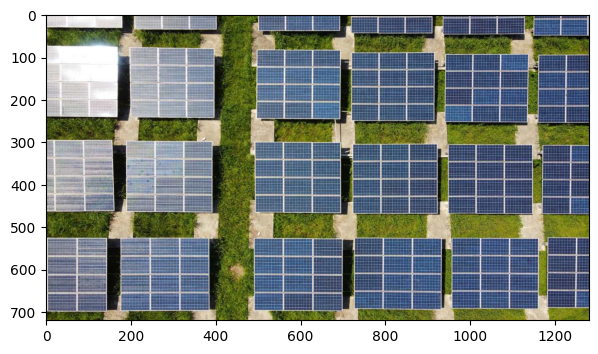

In [ ]:
plot(test_images)

For testing the models, we need to normalize the test images. and for the Unet-segmentation model, we need to resize our test images to 256*256

In [ ]:
transform = torchvision.transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225],
    )

In [ ]:
segment_test_data=[TF.resize(transform(img),size=[256,256]) for img in test_images]
object_detection_data = [transform(img) for img in test_images]

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [ ]:
def plot(image,label,box=None, score=0):
  image = image.transpose(0,2).transpose(0,1).detach().numpy()
  label = label.squeeze().detach().numpy()
  i, (im1) = plt.subplots(1,2)
  i.set_figwidth(10)
  im1[0].imshow(image)
  if box is not None:
    box = box.detach().numpy()
    rect = patches.Rectangle((box[0],box[1]), box[2]-box[0], box[3]-box[1],
                             linewidth=1, edgecolor='r', facecolor='none')
    im1[0].add_patch(rect)
  im1[1].imshow(label)

  if score >0:
    plt.figtext(0.5, 0.01, f"Score: {score}", wrap=True, horizontalalignment='center', fontsize=12)

#Load and Evaluate the Model

## Unet

In [ ]:
from torch.nn import ConvTranspose2d
from torch.nn import Conv2d
from torch.nn import MaxPool2d
from torch.nn import Module
from torch.nn import ModuleList
from torch.nn import ReLU
from torchvision.transforms import CenterCrop
from torch.nn import functional as F
import torch

class Block(Module):
	def __init__(self, inChannels, outChannels):
		super().__init__()
		self.conv1 = Conv2d(inChannels, outChannels, 3)
		self.relu = ReLU()
		self.conv2 = Conv2d(outChannels, outChannels, 3)
	def forward(self, x):
		return self.conv2(self.relu(self.conv1(x)))


class Encoder(Module):
	def __init__(self, channels):
		super().__init__()
		self.encBlocks = ModuleList(
			[Block(channels[i], channels[i + 1])
			 	for i in range(len(channels) - 1)])
		self.pool = MaxPool2d(2)
	def forward(self, x):
		blockOutputs = []
		for block in self.encBlocks:
			x = block(x)
			blockOutputs.append(x)
			x = self.pool(x)
		return blockOutputs

class Decoder(Module):
	def __init__(self, channels=(64, 32, 16)):
		super().__init__()
		self.channels = channels
		self.upconvs = ModuleList(
			[ConvTranspose2d(channels[i], channels[i + 1], 2, 2)
			 	for i in range(len(channels) - 1)])
		self.dec_blocks = ModuleList(
			[Block(channels[i], channels[i + 1])
			 	for i in range(len(channels) - 1)])
	def forward(self, x, encFeatures):
		for i in range(len(self.channels) - 1):
			x = self.upconvs[i](x)
			encFeat = self.crop(encFeatures[i], x)
			x = torch.cat([x, encFeat], dim=1)
			x = self.dec_blocks[i](x)
		return x
	def crop(self, encFeatures, x):
		(_, _, H, W) = x.shape
		encFeatures = CenterCrop([H, W])(encFeatures)
		return encFeatures


class UNet(Module):
	def __init__(self, encChannels=(1, 16, 32, 64),
		 decChannels=(64, 32, 16),
		 nbClasses=1, retainDim=True,
		 outSize=(256,  256)):
		super().__init__()
		self.encoder = Encoder(encChannels)
		self.decoder = Decoder(decChannels)
		self.head = Conv2d(decChannels[-1], nbClasses, 1)
		self.retainDim = retainDim
		self.outSize = outSize
	def forward(self, x):
		encFeatures = self.encoder(x)
		decFeatures = self.decoder(encFeatures[::-1][0],
			encFeatures[::-1][1:])
		map = self.head(decFeatures)
		if self.retainDim:
			map = F.interpolate(map, self.outSize)
		return map

In [ ]:
unet_model = UNet(encChannels=(3, 16, 32, 64))
checkpoint = torch.load(f"saved_model/seg_w.pt")
unet_model.load_state_dict(checkpoint['model_state_dict'])
unet_model.eval()

In [ ]:
output = [unet_model(img.unsqueeze(dim=0)) for img in segment_test_data]

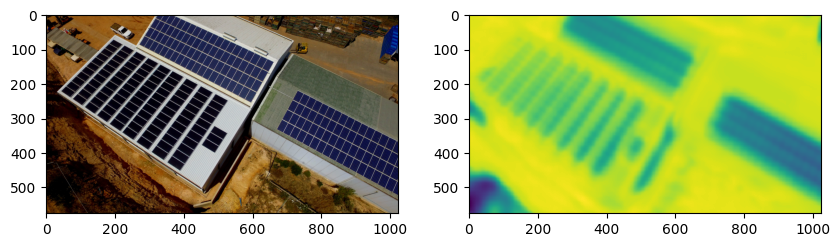

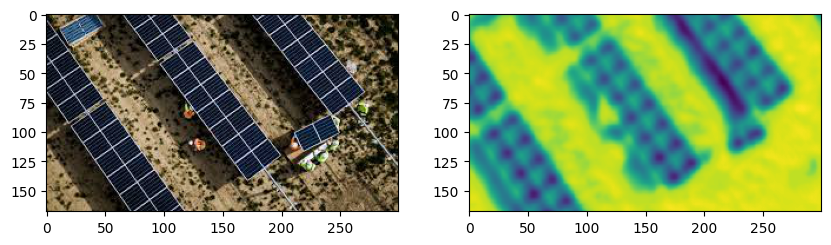

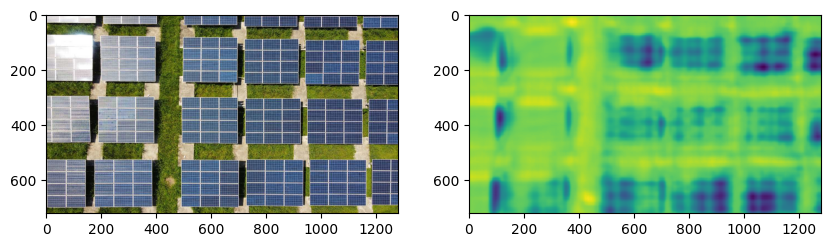

In [ ]:
for mask,img in zip(output,test_images):
  size = img.size()[1:]
  mask = TF.resize(mask,size = size)
  plot(img,mask)

I believe the results can improve using data augmentation. :(

## Masked RCNN

In [ ]:
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

num_classes= 2

masked_rcnn_model = torchvision.models.detection.maskrcnn_resnet50_fpn(weights="DEFAULT")

in_features = masked_rcnn_model.roi_heads.box_predictor.cls_score.in_features
masked_rcnn_model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

in_features_mask = masked_rcnn_model.roi_heads.mask_predictor.conv5_mask.in_channels
hidden_layer = 256

masked_rcnn_model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                    hidden_layer,
                                                    num_classes)

checkpoint = torch.load(f"saved_model/obj_det_w.pt",map_location=torch.device('cpu'))
masked_rcnn_model.load_state_dict(checkpoint['model_state_dict'])
masked_rcnn_model.eval()

In [ ]:
output = [masked_rcnn_model(img.unsqueeze(dim=0)) for img in object_detection_data]

<ipython-input-35-4badda8a8a76>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  i, (im1) = plt.subplots(1,2)


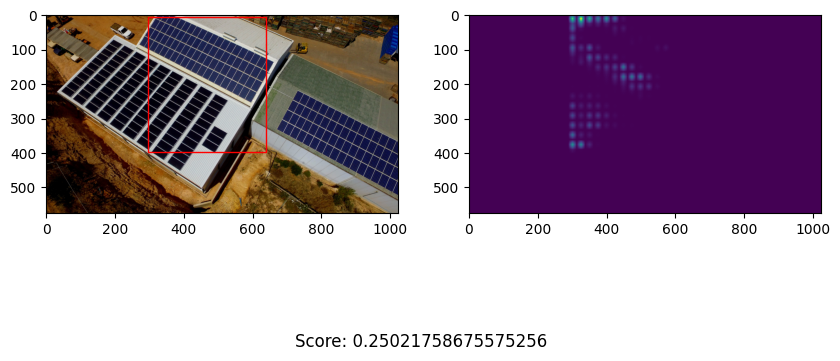

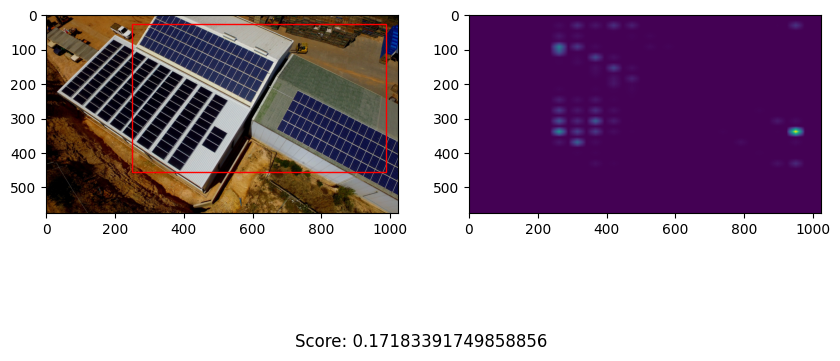

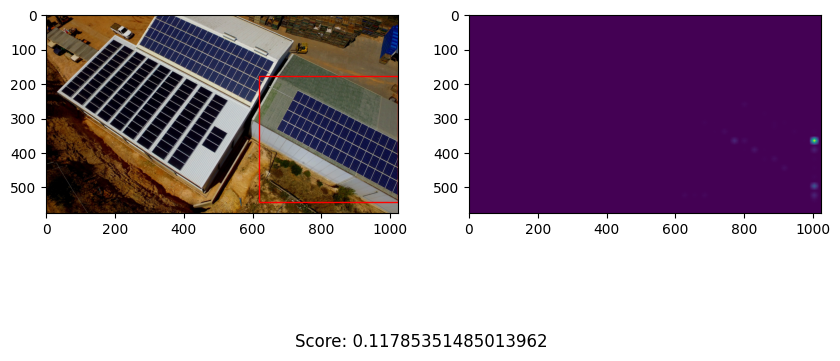

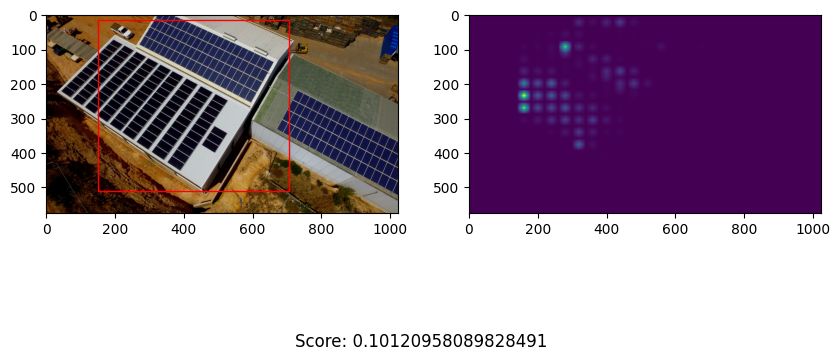

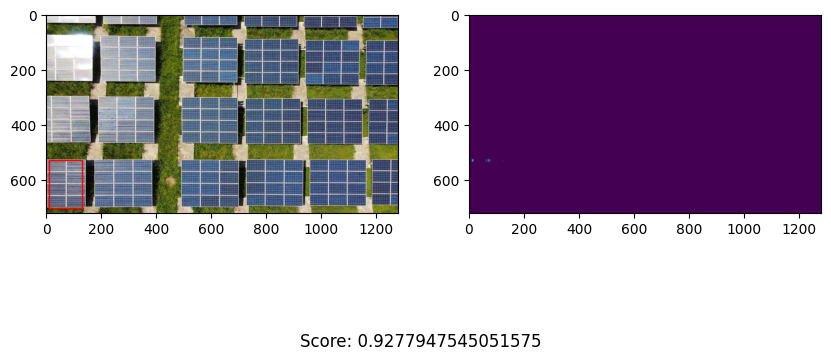

...

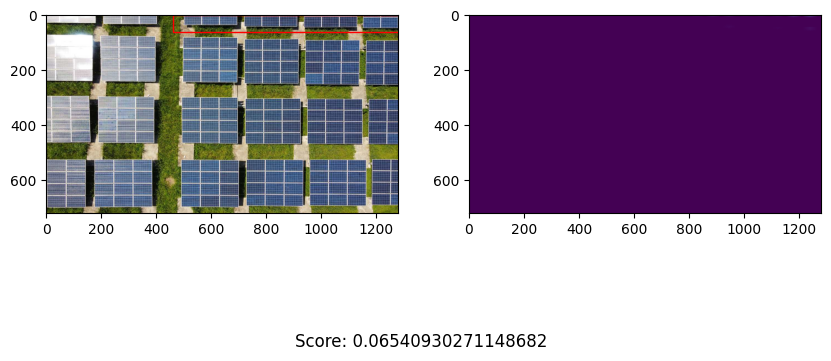

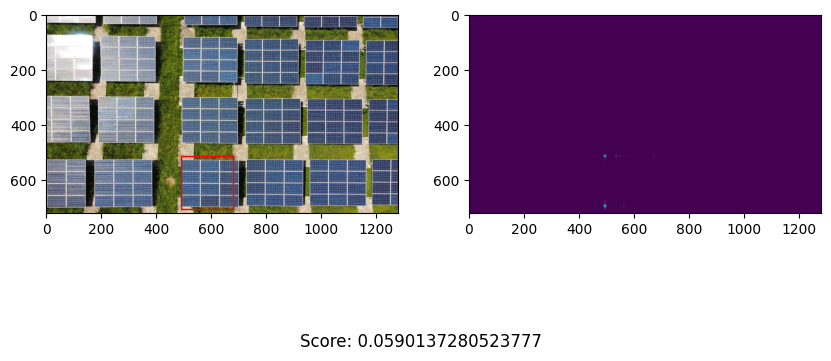

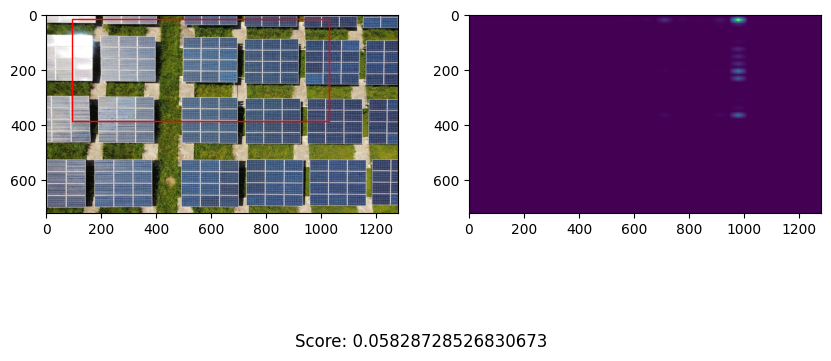

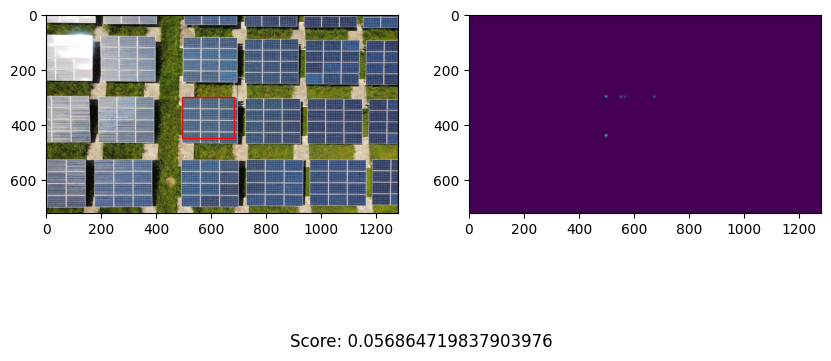

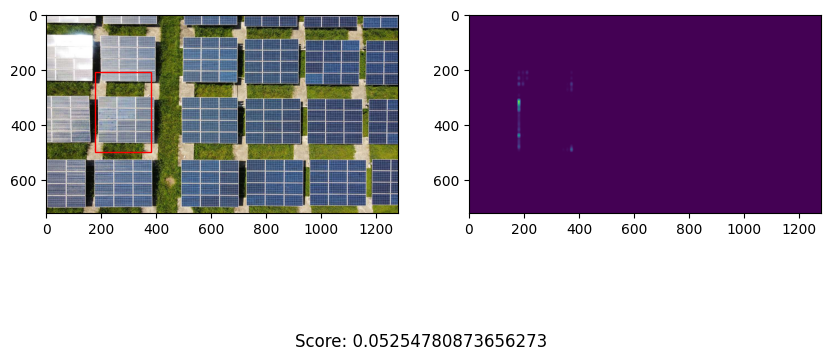

In [ ]:
for result,image in zip(output,test_images):
  boxes = result[0]["boxes"]
  masks = result[0]["masks"]
  score = result[0]["scores"]
  for b,m,s in zip(boxes,masks,score):
    plot(image, m, b, s)


##FPN Segment

In [ ]:
import torch

fpn_model = torch.hub.load(
	'AdeelH/pytorch-fpn',
	'make_fpn_resnet',
	name='resnet18',
	fpn_type='panoptic',
	num_classes=2,
	fpn_channels=256,
	in_channels=3,
	out_size=(256, 256)
)

checkpoint = torch.load(f"saved_model/fpn_seg_w_2.pt",map_location=torch.device('cpu'))
fpn_model.load_state_dict(checkpoint['model_state_dict'])
fpn_model.eval()

output = [fpn_model(img.unsqueeze(dim=0)) for img in segment_test_data]

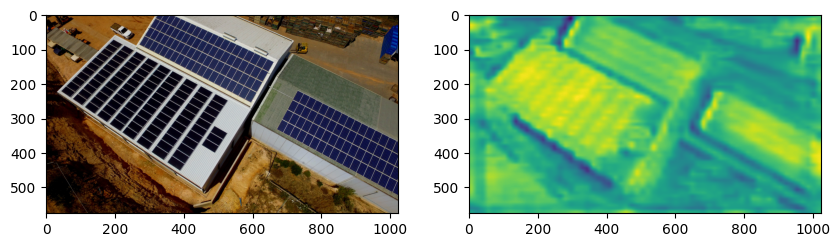

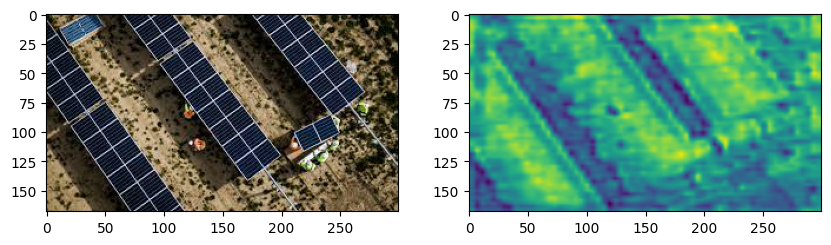

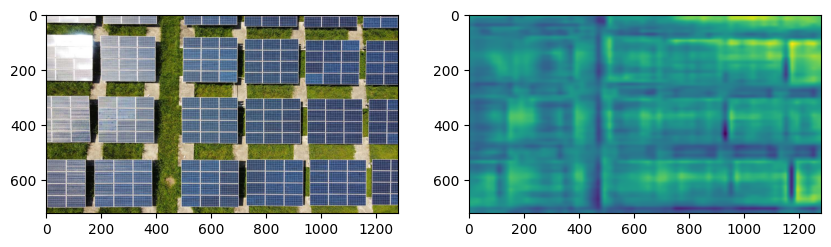

In [ ]:
for mask,img in zip(output,test_images):
  size = img.size()[1:]
  mask = TF.resize(mask,size = size)
  plot(img,mask[0][1])

## PSP NET

In [ ]:
!pip install -q segmentation-models-pytorch albumentations
import segmentation_models_pytorch as smp

ENCODER = 'resnext50_32x4d'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = ["background", "panel"]
ACTIVATION = 'sigmoid'

psp_model = smp.PSPNet(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=len(CLASSES),
    activation=ACTIVATION,
)

checkpoint = torch.load(f"saved_model/psp_seg_w.pt",map_location=torch.device('cpu'))
psp_model.load_state_dict(checkpoint['model_state_dict'])
psp_model.eval()

output = [psp_model(img.unsqueeze(dim=0)) for img in segment_test_data]

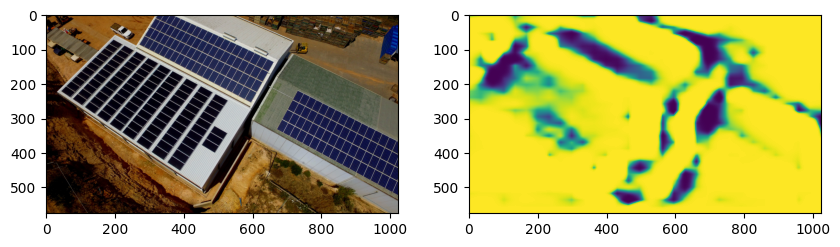

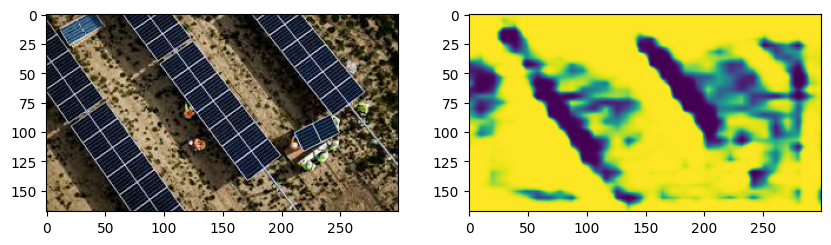

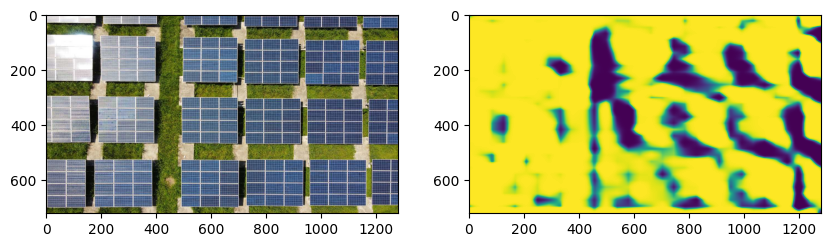

In [ ]:
for mask,img in zip(output,test_images):
  size = img.size()[1:]
  mask = TF.resize(mask,size = size)
  plot(img,mask[0][0])

## Retina

In [ ]:
from torchvision.models.detection import retinanet_resnet50_fpn


retina_model = retinanet_resnet50_fpn(pretrained=True)

num_anchors = retina_model.head.classification_head.num_anchors
retina_model.head.classification_head.num_classes = 2

cls_logits = torch.nn.Conv2d(256, num_anchors * 2, kernel_size = 3, stride=1, padding=1)
retina_model.head.classification_head.cls_logits = cls_logits

checkpoint = torch.load(f"saved_model/retina_obj_det_w_2.pt",map_location=torch.device('cpu'))
retina_model.load_state_dict(checkpoint['model_state_dict'])
retina_model.eval()

output = [retina_model(img.unsqueeze(dim=0)) for img in object_detection_data]

In [ ]:
def plot(image,box=None, score=0):
  image = image.transpose(0,2).transpose(0,1).detach().numpy()
  i, (im1) = plt.subplots()
  i.set_figwidth(10)
  im1.imshow(image)
  if box is not None:
    box = box.detach().numpy()
    rect = patches.Rectangle((box[0],box[1]), box[2]-box[0], box[3]-box[1],
                             linewidth=1, edgecolor='r', facecolor='none')
    im1.add_patch(rect)

  if score >0:
    plt.figtext(0.5, 0.01, f"Score: {score}", wrap=True, horizontalalignment='center', fontsize=12)

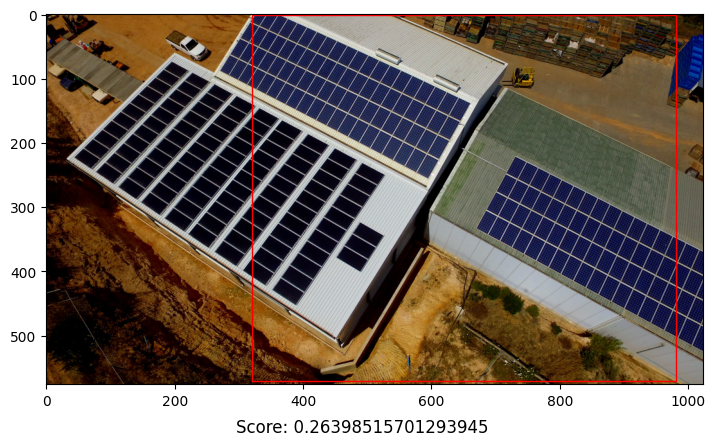

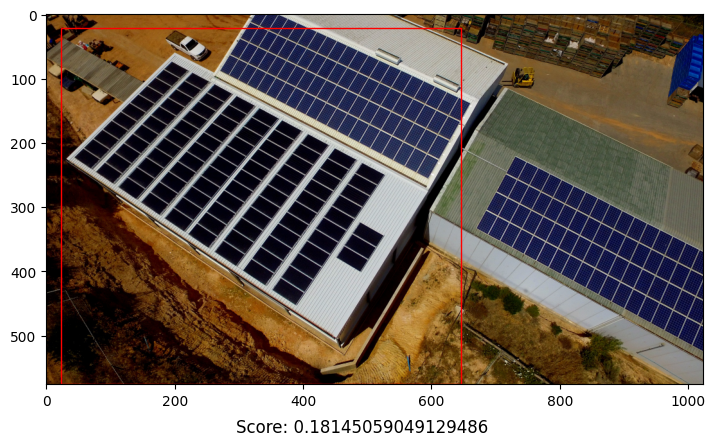

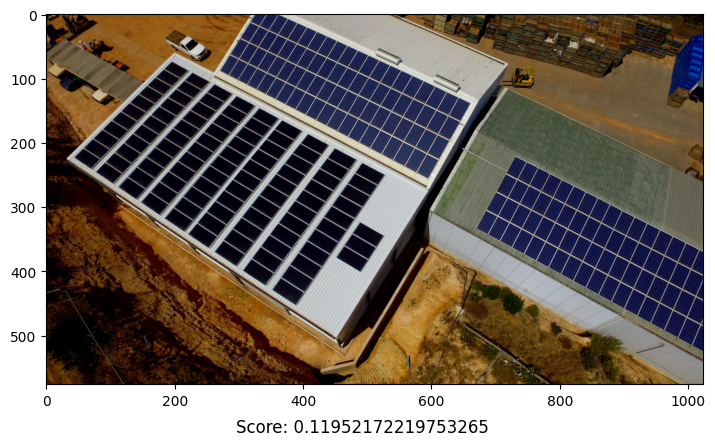

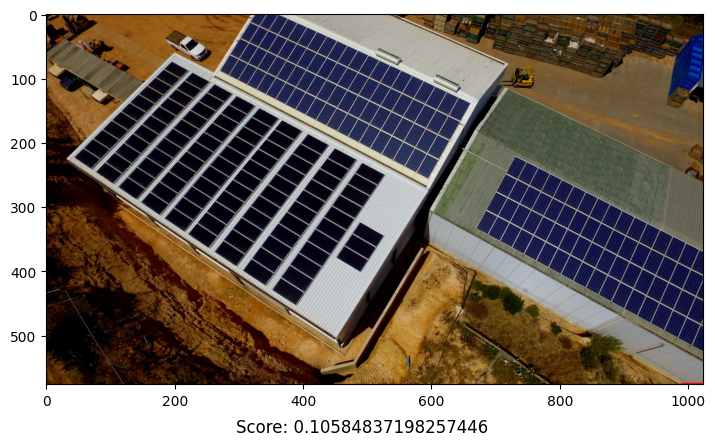

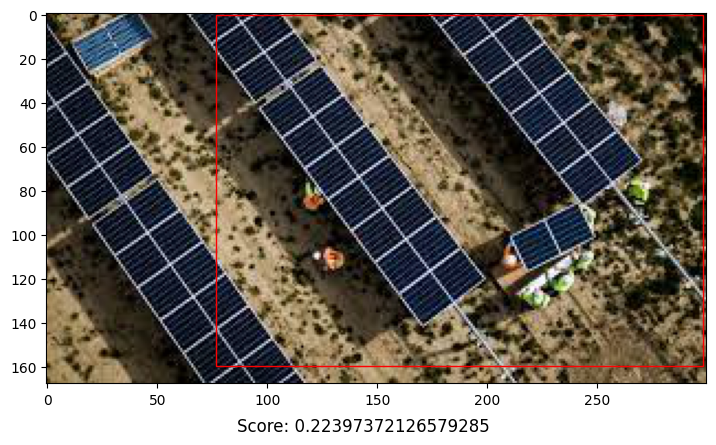

...

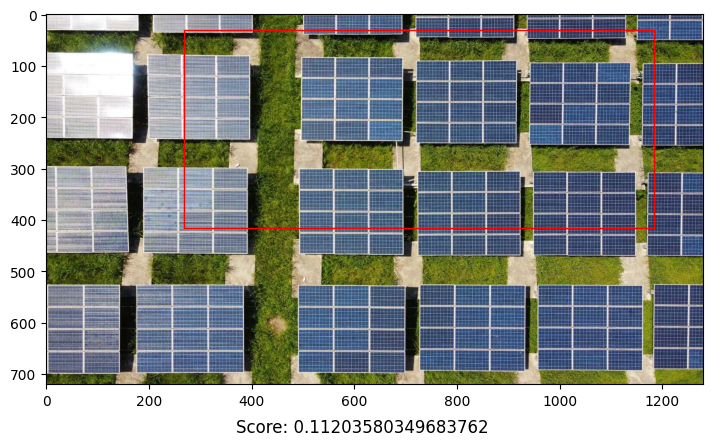

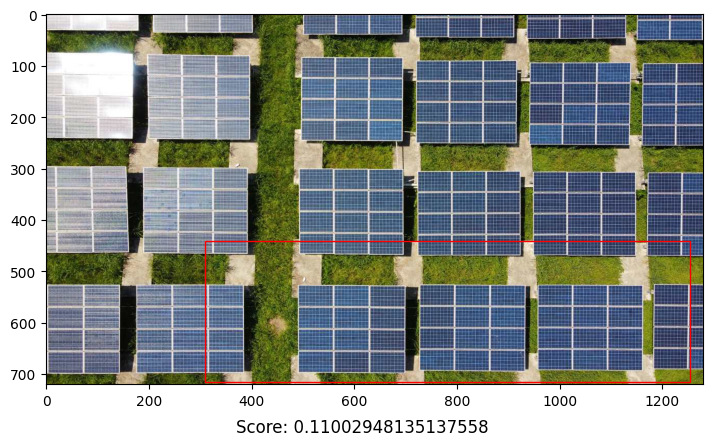

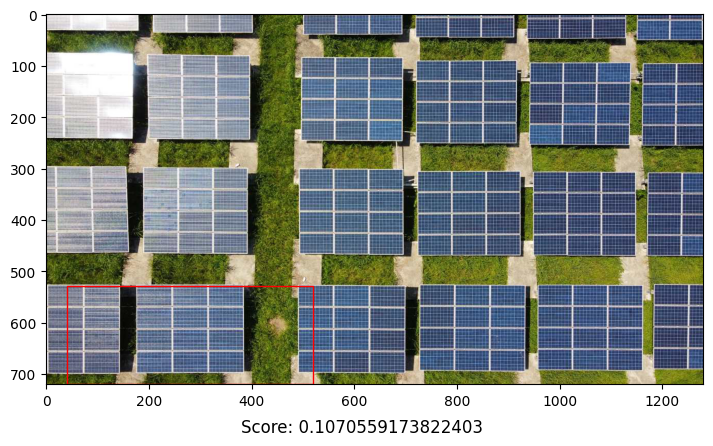

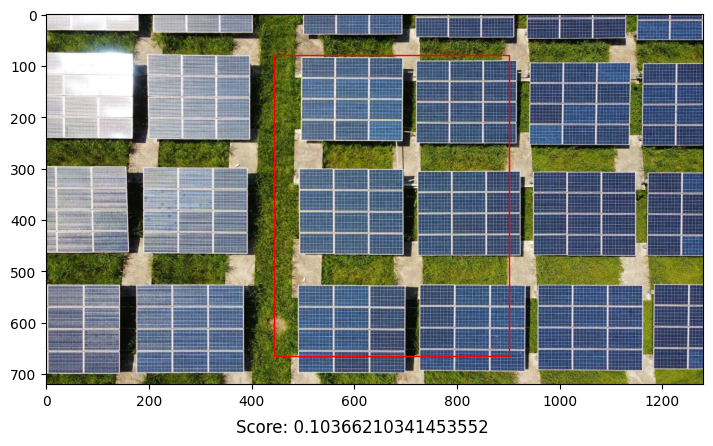

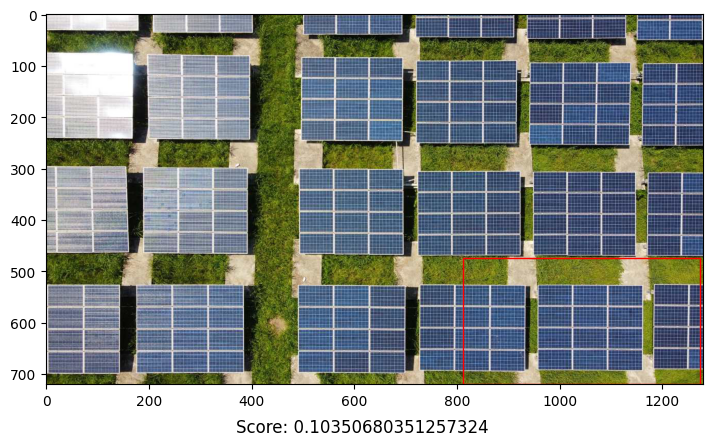

In [ ]:
for result,image in zip(output,test_images):
  boxes = result[0]["boxes"]
  score = result[0]["scores"]
  for b,s in zip(boxes,score):
    plot(image, b, s)

## Conclusion
In this test project, we trained and evaluated 5 models, two for detecting and 3 for semantic segmentation. The data set is 735 pictures of solar panels taken by satellite. The images have different backgrounds, angles, and panel sizes. The test images are totally different images from the Internet.

We see that our U-net has performed the best between these models for segmentation. We have different sizes of panels in our picture, and therefore the FPN-based methods should work better, because of several intermediary feature maps it uses. But we see differences in our results. This may be due to the choice of the hyperparameters, or the size of our dataset.

In the case of object detection, both models were FPN based with a different backbone. MaskedRCNN is better at recognizing the small size panels, as we see in the third test image, but this model failed to detect anything in the second test image (maybe because of the different light). The Retina Network has detected two areas in the second test image, but its result on the third image is not better than MaskedRCNN.

related to this case, I have read a [report](https://egrove.olemiss.edu/cgi/viewcontent.cgi?article=2484&context=hon_thesis) [1] on the performance of Unet, FPN Base models, and PSP models. In the conclusion section, the author claimed that these models have similar performance.


As I have read, it seems that FPN-based networks need a large amount of data to train and may be challenging to fine-tune. But the structure is powerful and can predict the target accurately.
The PSP-Nets take advantage of multi-scale feature extraction to accurately segment different parts of the image. But it's a complex model and it's sensitive to hyper-parameter.

---


[1] Nagarkar, Harsh, "Evaluating Machine Learning Models for Semantic Segmentation over Cloud Images for
Classification" (2020). Honors Theses. 1538.